In [1]:
import sys
sys.path.append('/'.join(sys.path[0].split('/')[:-1]))

import xarray as xr
import numpy as np
import pickle

from modules.plotting import plot_general_skills, plot_benchmark, plot_skillmaps
from modules.test import (compute_rmse_healpix, compute_relBIAS, compute_rSD, compute_R2, compute_anomalies, 
                          compute_relMAE, compute_ACC)

# Inputs
prediction_path = '../data/healpix/predictions/'
metrics_path = '../data/healpix/metrics/'
figures_path = '../data/healpix/figures/'

resolution = 5.625
lead_time = 6
len_sqce = 2
max_lead_time = 5*24
model_description = "all_const_len{}_delta{}".format(len_sqce, lead_time)
start_time = len_sqce * lead_time - 6
end_time = (6-lead_time) if (6-lead_time) > 0 else None

# Data
lead_times = np.arange(lead_time, max_lead_time+lead_time, lead_time)

obs = xr.open_mfdataset(prediction_path + 'observations.nc', combine='by_coords')
pred = xr.open_mfdataset(prediction_path + 'spherical_unet_' + model_description + '.nc', combine='by_coords')

obs = obs.sel(lead_time=lead_times).isel(time=slice(start_time, end_time))

# Maps
corr_map = compute_R2(pred, obs, dims=('time'))
rbias_map = compute_relBIAS(pred, obs, dims=('time'))
rsd_map = compute_rSD(pred, obs, dims=('time'))
rmse_map = compute_rmse_healpix(pred, obs, dims=('time'))
obs_rmse = np.sqrt(((obs)**2).mean(('node', 'time')))
rmse_map_norm = rmse_map / obs_rmse

# Metrics
#rmse_spherical = compute_rmse_healpix(pred, obs)
rmse_spherical = xr.load_dataset(metrics_path + 'rmse_' + model_description + '.nc')
rbias_spherical = rbias_map.mean('node').compute()
rsd_spherical = rsd_map.mean('node').compute()
corr_spherical = corr_map.mean('node').compute()

#rmse_spherical.to_netcdf(metrics_path + 'rmse_' + model_description + '.nc')
rbias_spherical.to_netcdf(metrics_path + 'rbias_' + model_description + '.nc')
rsd_spherical.to_netcdf(metrics_path + 'rsd_' + model_description + '.nc')
corr_spherical.to_netcdf(metrics_path + 'corr_' + model_description + '.nc')

a = 1

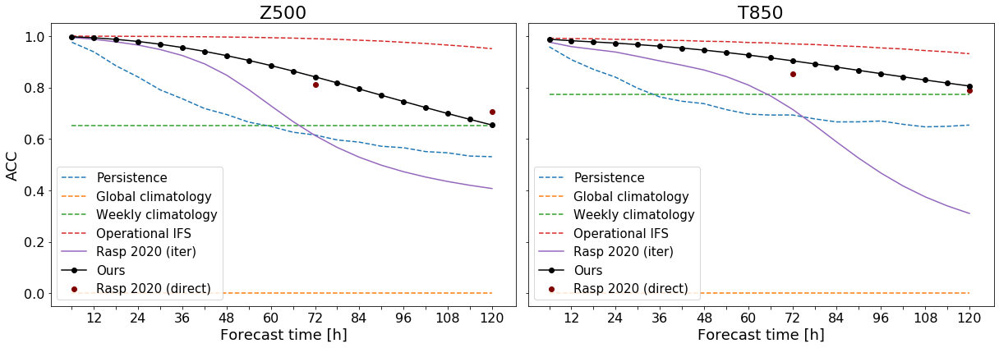

In [126]:
plot_benchmark_ACC(acc, model_description, lead_times, 
               input_dir=metrics_path, output_dir=figures_path, title=False)

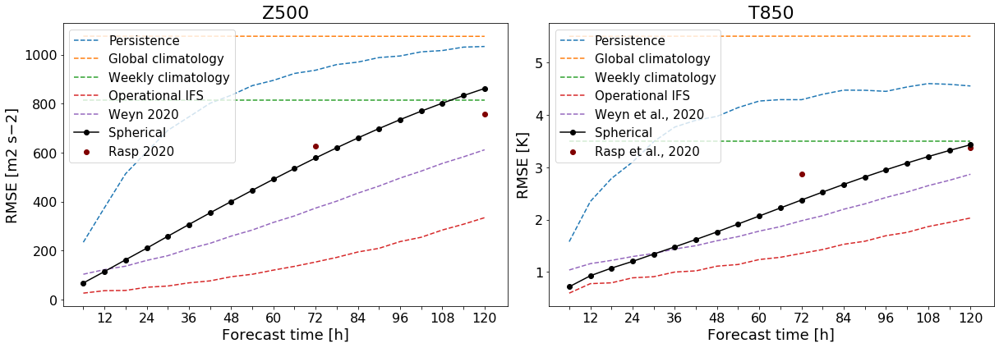

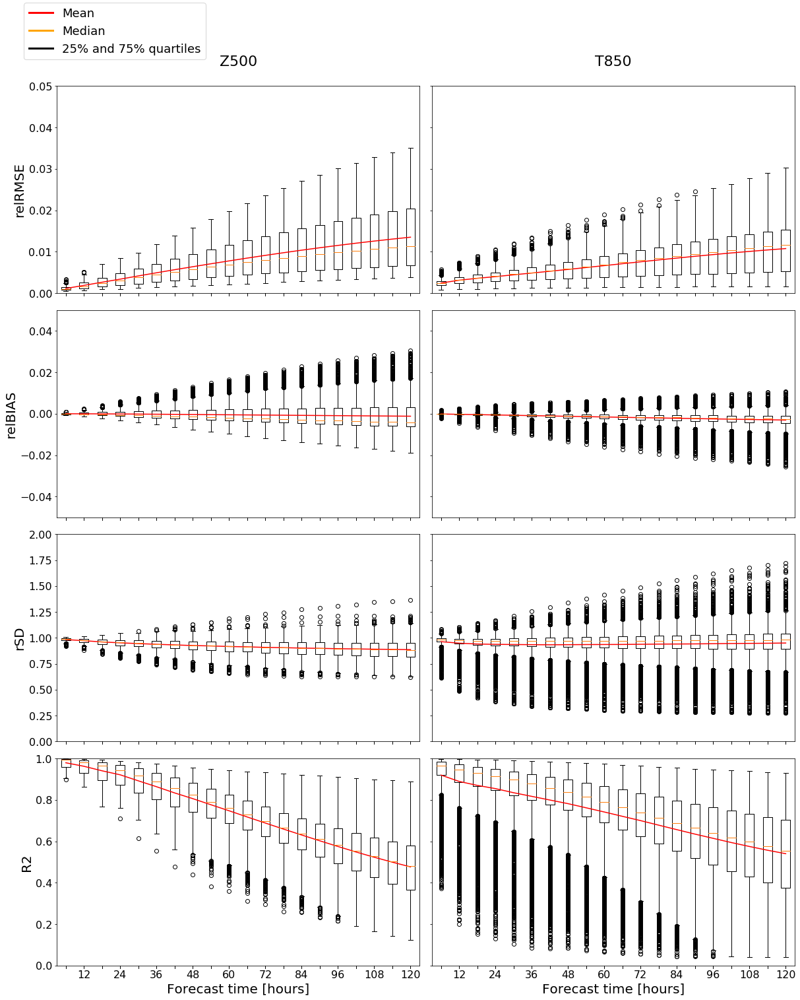

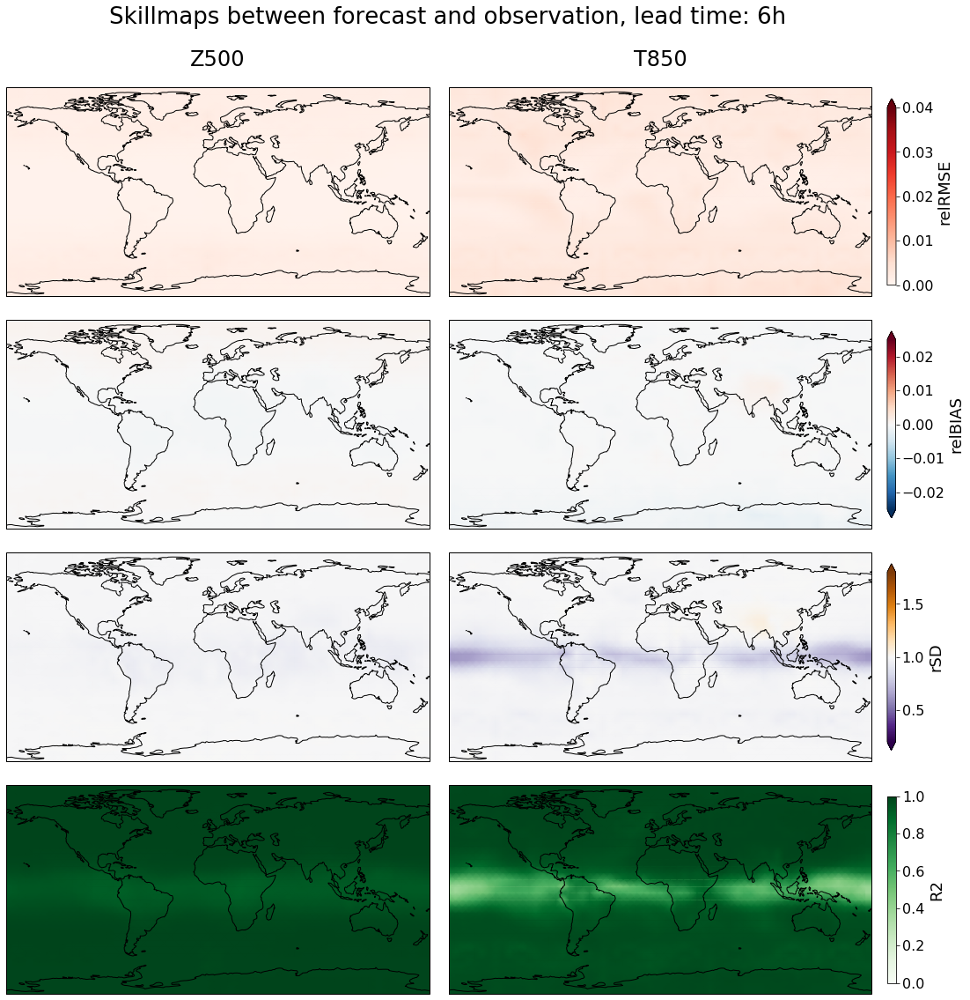

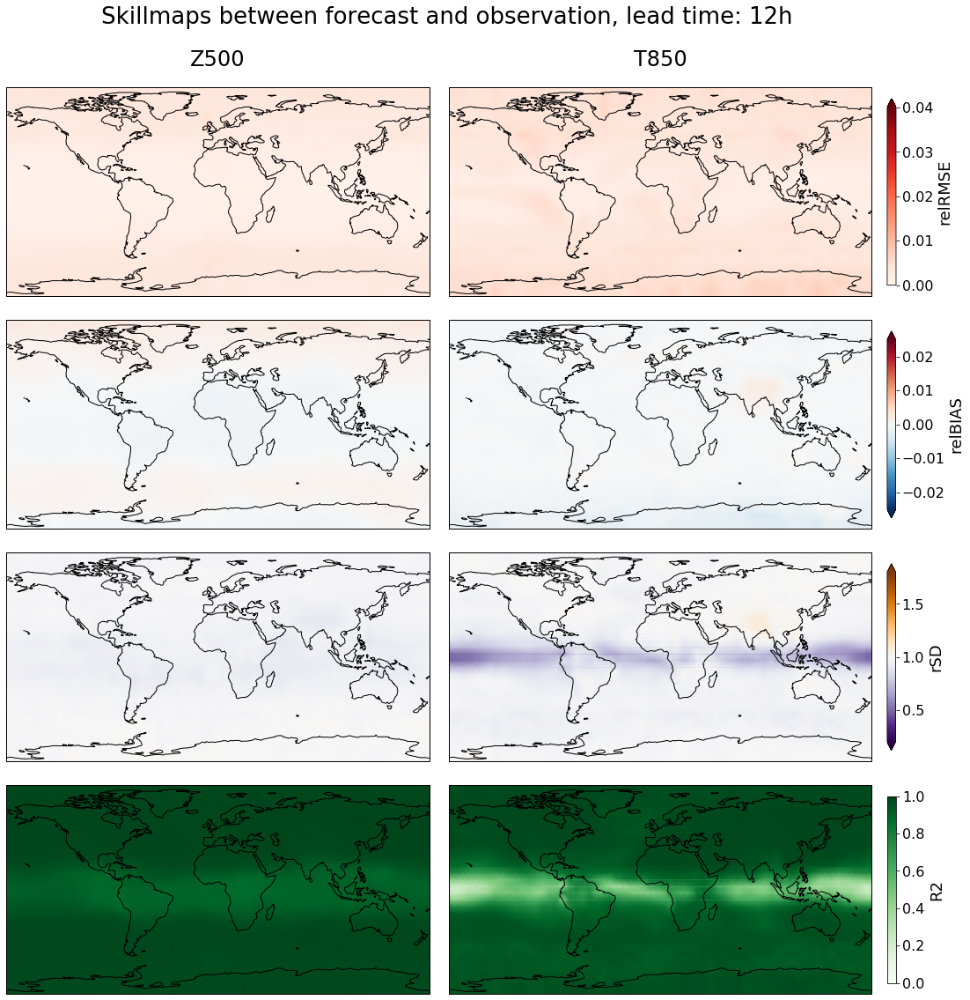

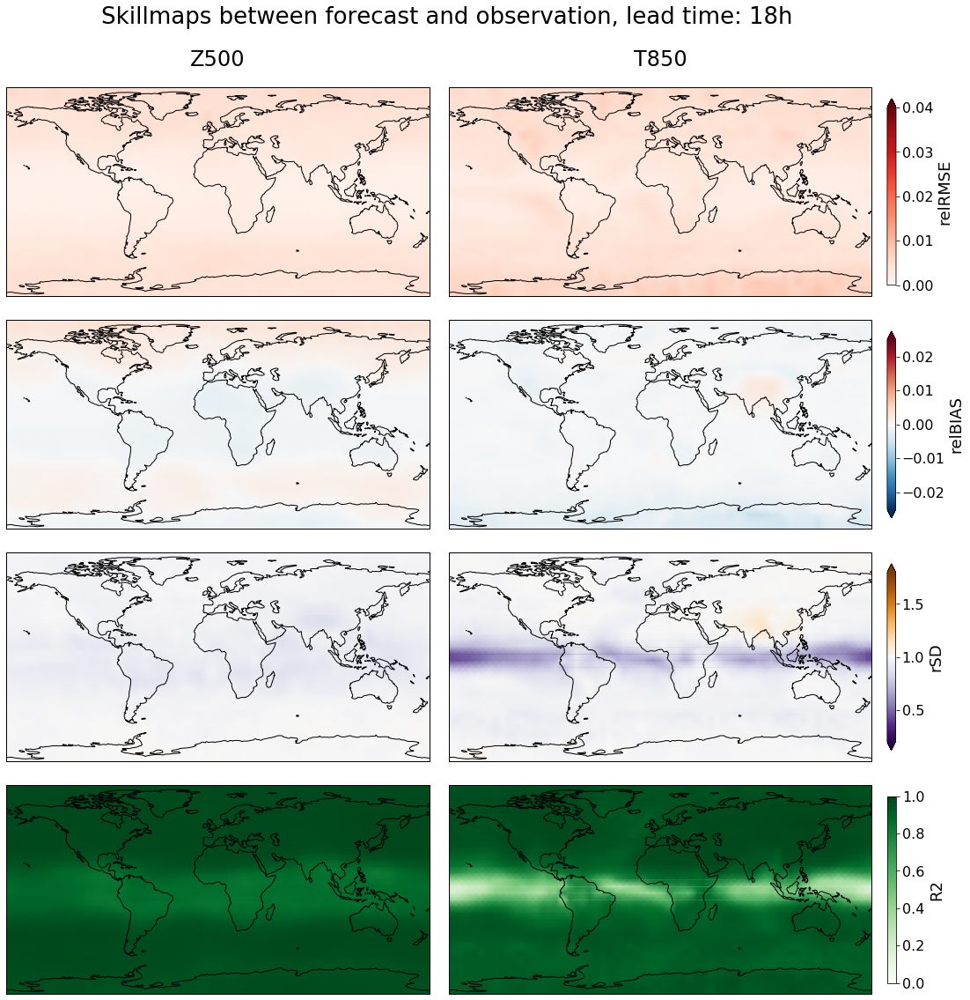

...

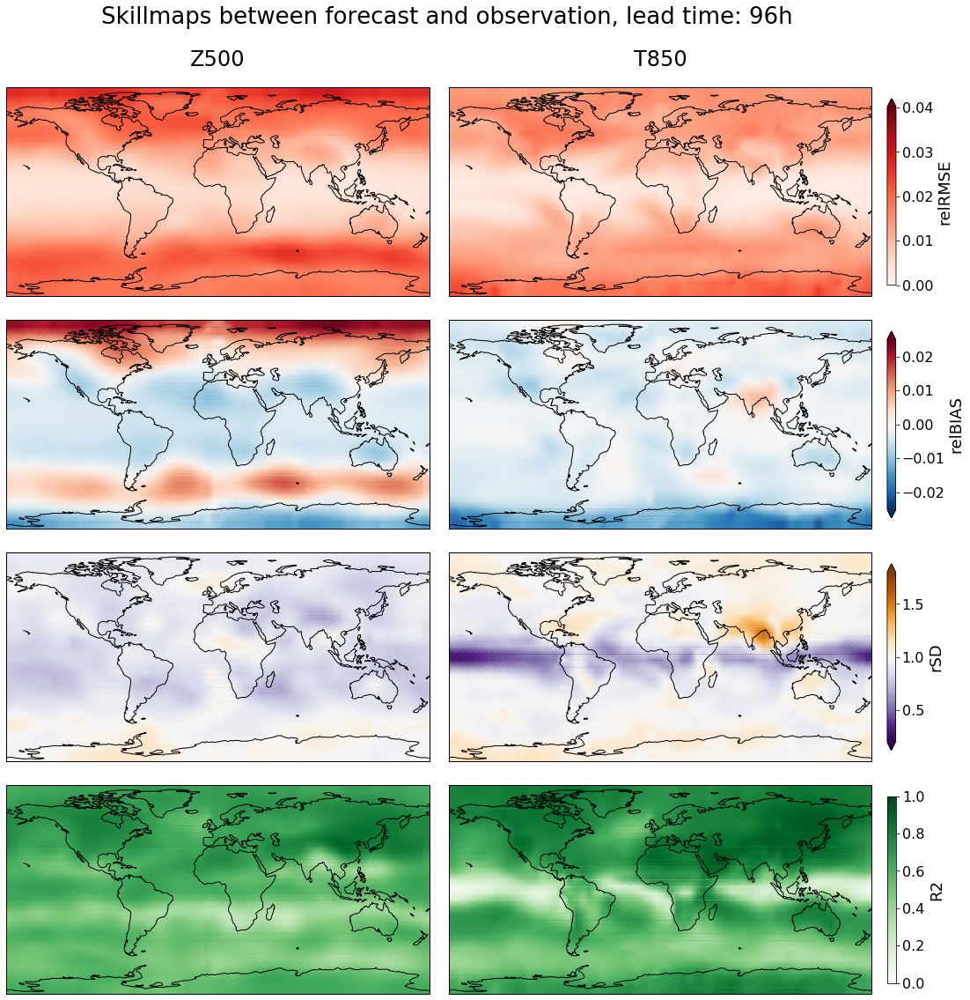

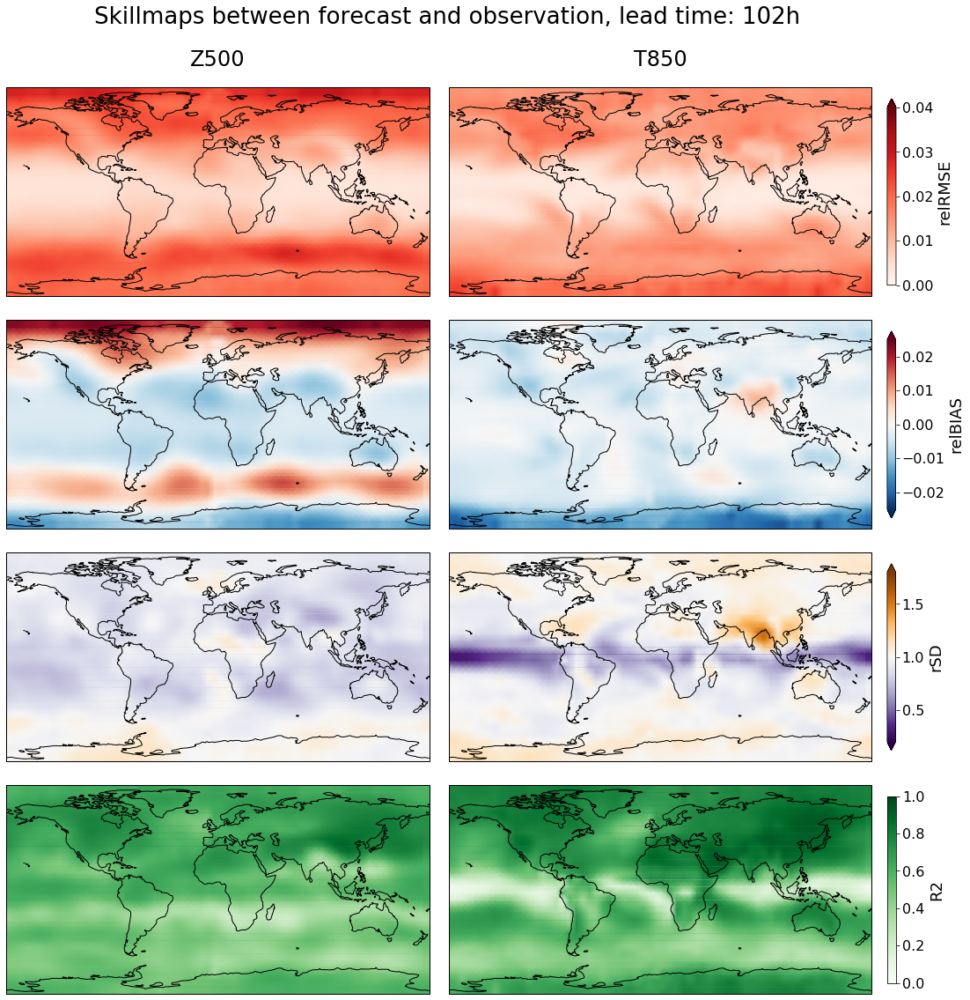

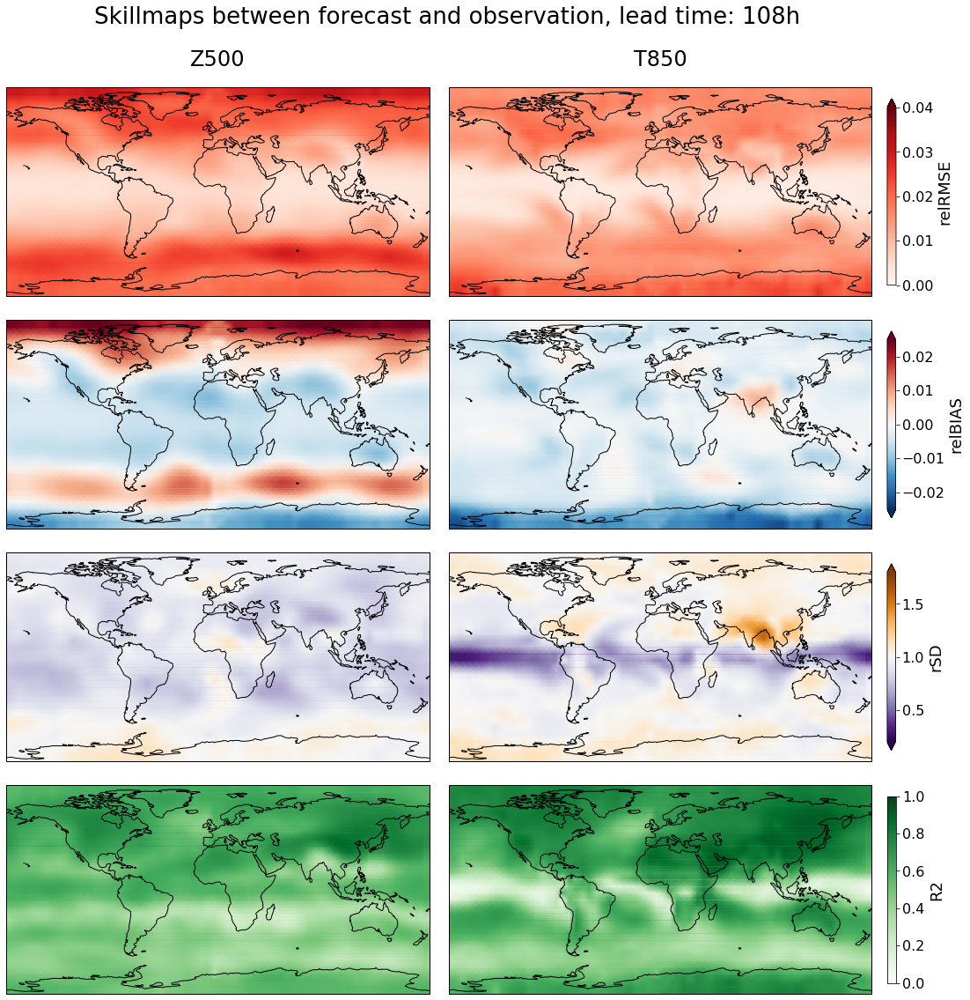

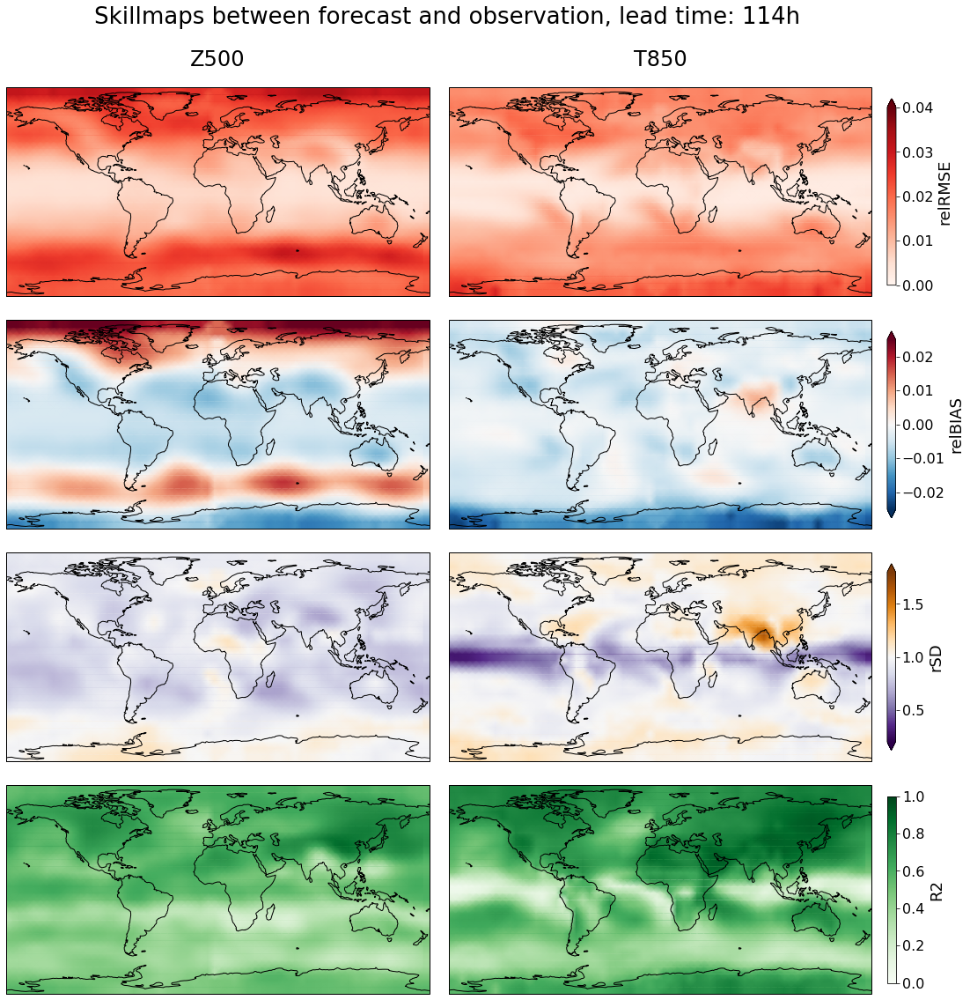

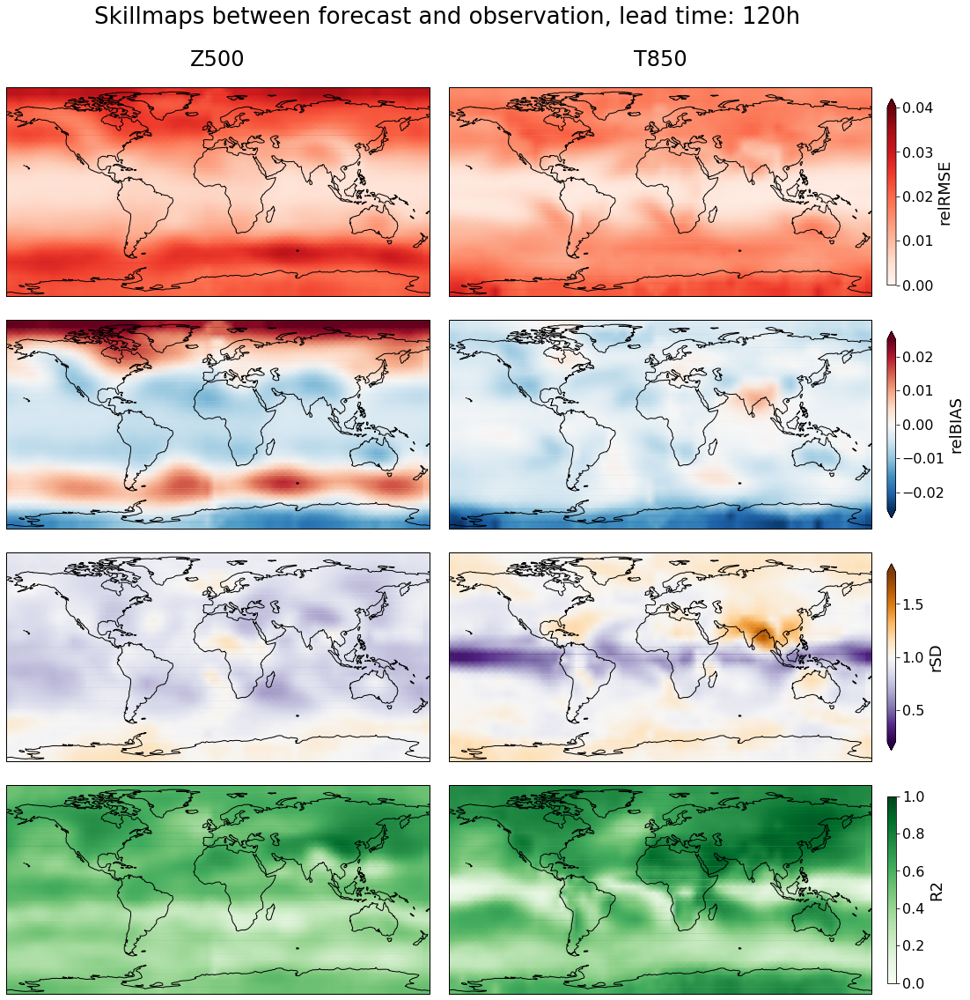

In [7]:
# Plots
plot_benchmark(rmse_spherical, model_description, lead_times, 
               input_dir=metrics_path, output_dir=figures_path, title=False)

plot_general_skills(rmse_map_norm, corr_map, rbias_map, rsd_map, model_description, lead_times, 
                    output_dir=figures_path, title=False)

plot_skillmaps(rmse_map_norm, rsd_map, rbias_map, corr_map, model_description, lead_times, resolution, 
               output_dir=figures_path)

# Weekly climatology spatial comparison

In [29]:
import matplotlib.pyplot as plt
from matplotlib.axes import Axes
from matplotlib.lines import Line2D
from matplotlib import cm, colors
from cartopy.mpl.geoaxes import GeoAxes
import cartopy.crs as ccrs
import cartopy
GeoAxes._pcolormesh_patched = Axes.pcolormesh

from modules.data import hp_to_equiangular

lats = np.arange(-90+resolution/2, 90, resolution)
lons = np.arange(0, 360, resolution)


In [3]:
weekly_clim = xr.open_dataset(prediction_path + 'weekly_climatology_hp_10days.nc')
weekly_clim = weekly_clim.sel(time=slice(pred.time.values[0], pred.time.values[-1]))
weekly_clim = weekly_clim.expand_dims({'lead_time':np.arange(6, 126, 6)})
weekly_clim.lead_time.values = obs.lead_time.values

rmse_map = compute_rmse_healpix(pred, obs, dims=('time'))
obs_rmse = np.sqrt(((obs)**2).mean(('time')))
rmse_map_norm = rmse_map / obs_rmse

rmse_map_c = compute_rmse_healpix(weekly_clim, obs, dims=('time'))
rmse_map_norm_c = rmse_map_c / obs_rmse

rmse_comp_z = np.zeros((32, 64))
rmse_comp_t = np.zeros((32, 64))

for i in range(20):
    clim_equi = hp_to_equiangular(rmse_map_c.isel(lead_time=i), resolution)
    pred_equi = hp_to_equiangular(rmse_map.isel(lead_time=i), resolution)
    
    comparison = (clim_equi < pred_equi)
    
    rmse_comp_z += 6*(1 - comparison.z.values.astype(int))
    rmse_comp_t += 6*(1 - comparison.t.values.astype(int))



rmse_comp = xr.Dataset({'z': (['lat', 'lon'], rmse_comp_z),
                 't': (['lat', 'lon'], rmse_comp_t)},
                coords={'lon': lons, 'lat': lats})

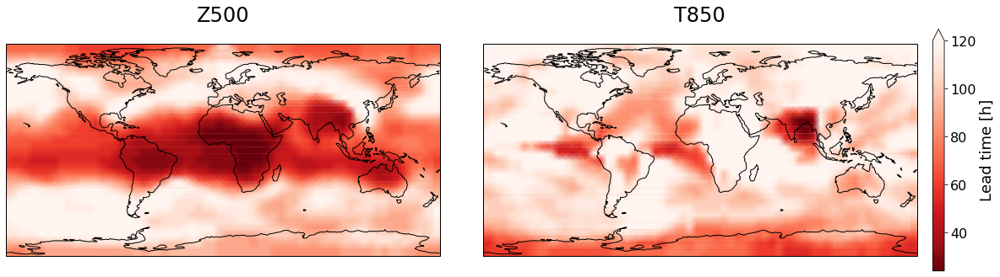

In [41]:
proj = ccrs.PlateCarree()

f, axs = plt.subplots(1, 2, figsize=(17, 6), subplot_kw=dict(projection=proj))

cols = ['Z500', 'T850']

for ax, col in zip(axs, cols):
    ax.set_title(col, fontsize=24, y=1.08)

plot_signal(f, sample=rmse_comp, var='z', vmin=24, vmax=120, proj=proj, ax=axs[0], 
            cmap='Reds_r', colorbar=False, cbar_label='', extend='max')
plot_signal(f, sample=rmse_comp, var='t', vmin=24, vmax=120, proj=proj, ax=axs[1], 
            cmap='Reds_r', colorbar=True, cbar_label='Lead time [h]', extend='max')

plt.tight_layout()

plt.savefig('clim_pred_comparison.png', bbox_inches='tight')

# Climatology Hovmoller

In [140]:
import sys
sys.path.append('/'.join(sys.path[0].split('/')[:-1]))

import xarray as xr
import numpy as np
import healpy as hp
import matplotlib.pyplot as plt
from matplotlib import cm, colors
import pandas as pd

from modules.plotting import plot_general_skills, plot_benchmark, plot_skillmaps
from modules.test import compute_rmse_healpix, compute_relBIAS, compute_rSD, compute_R2, compute_anomalies
from modules.data import hp_to_equiangular

# Inputs
prediction_path = '../data/healpix/predictions/'
metrics_path = '../data/healpix/metrics/'
figures_path = '../data/healpix/figures/'

resolution = 5.625
lead_time = 6
max_lead_time = 5*24
model_description = "all_const_len2_delta6"

pred = xr.open_mfdataset(prediction_path + 'spherical_unet_' + model_description + '.nc', combine='by_coords')
obs = xr.open_mfdataset(prediction_path + 'observations.nc', combine='by_coords')

monthly_mean = pred.groupby('time.month').mean().compute()
monthly_mean_obs = obs.groupby('time.month').mean().compute()

In [142]:
lead_idx = 19

# Computations
monthly_mean.isel(lead_time=lead_idx)
monthly_mean_eq = []
for month in range(12):
    monthly_mean_eq.append(hp_to_equiangular(monthly_mean.isel(lead_time=lead_idx, month=month), 
                                     resolution))
monthly_mean_eq = xr.concat(monthly_mean_eq, pd.Index(np.arange(1, 13, 1), name='month'))
monthly_lat_eq = monthly_mean_eq.mean('lon')

monthly_mean_obs.isel(lead_time=lead_idx)
monthly_mean_eq_obs = []
for month in range(12):
    monthly_mean_eq_obs.append(hp_to_equiangular(monthly_mean_obs.isel(lead_time=lead_idx, month=month), 
                                     resolution))
monthly_mean_eq_obs = xr.concat(monthly_mean_eq_obs, pd.Index(np.arange(1, 13, 1), name='month'))
monthly_lat_eq_obs = monthly_mean_eq_obs.mean('lon')

pred_z = np.rot90(monthly_lat_eq.z.values, 3)
pred_t = np.rot90(monthly_lat_eq.t.values, 3)
obs_z = np.rot90(monthly_lat_eq_obs.z.values, 3)
obs_t = np.rot90(monthly_lat_eq_obs.t.values, 3)

diff_z = pred_z / obs_z
diff_t = pred_t / obs_t

# Labels and limits
ticks = np.linspace(0, 31, 7).astype(int)
lat_labels = np.linspace(-90, 90, 7).astype(int)
month_labels = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

vmin_z = min(np.min(monthly_lat_eq.z).values.flatten()[0], np.min(monthly_lat_eq_obs.z).values.flatten()[0])
vmax_z = max(np.max(monthly_lat_eq.z).values.flatten()[0], np.max(monthly_lat_eq_obs.z).values.flatten()[0])
vmin_t = min(np.min(monthly_lat_eq.t).values.flatten()[0], np.min(monthly_lat_eq_obs.t).values.flatten()[0])
vmax_t = max(np.max(monthly_lat_eq.t).values.flatten()[0], np.max(monthly_lat_eq_obs.t).values.flatten()[0])

delta = min((np.min(diff_z)-1), (1-np.max(diff_z)), (np.min(diff_t)-1), (1-np.max(diff_t)))

vmin_sd = 1 - delta
vmax_sd = 1 + delta

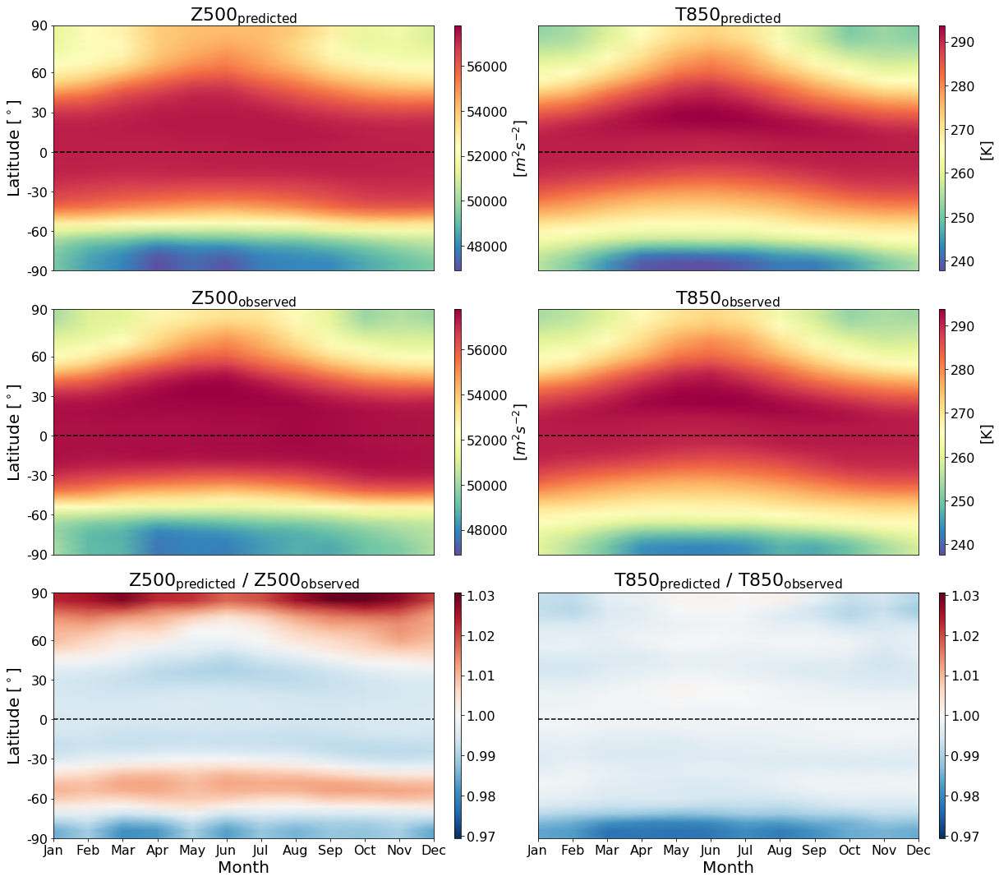

In [143]:
# Figure
f, axs = plt.subplots(3, 2, figsize=(17, 15))

# Plots

cax1 = axs[0, 0].pcolormesh(pred_z, cmap='Spectral_r', vmin=vmin_z, vmax=vmax_z, 
                            shading='gouraud')
axs[0, 0].axhline(y=15, linestyle='--', color='black')
cax2 = axs[0, 1].pcolormesh(pred_t, cmap='Spectral_r', vmin=vmin_t, vmax=vmax_t, 
                            shading='gouraud')
axs[0, 1].axhline(y=15, linestyle='--', color='black')
cax3 = axs[1, 0].pcolormesh(obs_z, cmap='Spectral_r', vmin=vmin_z, vmax=vmax_z, 
                            shading='gouraud')
axs[1, 0].axhline(y=15, linestyle='--', color='black')
cax4 = axs[1, 1].pcolormesh(obs_t, cmap='Spectral_r', vmin=vmin_t, vmax=vmax_t, 
                            shading='gouraud')
axs[1, 1].axhline(y=15, linestyle='--', color='black')
cax5 = axs[2, 0].pcolormesh(diff_z, cmap='RdBu_r', vmin=vmin_sd, vmax=vmax_sd, shading='gouraud')
axs[2, 0].axhline(y=15, linestyle='--', color='black')
cax6 = axs[2, 1].pcolormesh(diff_t, cmap='RdBu_r', vmin=vmin_sd, vmax=vmax_sd, shading='gouraud')
axs[2, 1].axhline(y=15, linestyle='--', color='black')


# Axes
axs[0, 0].set_title('Z500$_{\mathrm{\mathsf{predicted}}}$', fontsize=22)
axs[0, 1].set_title('T850$_{\mathrm{\mathsf{predicted}}}$', fontsize=22)
axs[1, 0].set_title('Z500$_{\mathrm{\mathsf{observed}}}$', fontsize=22)
axs[1, 1].set_title('T850$_{\mathrm{\mathsf{observed}}}$', fontsize=22)
axs[2, 0].set_title('Z500$_{\mathrm{\mathsf{predicted}}}$ / Z500$_{\mathrm{\mathsf{observed}}}$', fontsize=22)
axs[2, 1].set_title('T850$_{\mathrm{\mathsf{predicted}}}$ / T850$_{\mathrm{\mathsf{observed}}}$', fontsize=22)
axs[2, 0].set_xticks(np.arange(12))
axs[2, 0].set_xticklabels(month_labels, fontsize=16)
axs[2, 1].set_xticks(np.arange(12))
axs[2, 1].set_xticklabels(month_labels, fontsize=16)
axs[0, 0].set_yticks(ticks)
axs[0, 0].set_yticklabels(lat_labels, fontsize=16)
axs[1, 0].set_yticks(ticks)
axs[1, 0].set_yticklabels(lat_labels, fontsize=16)
axs[2, 0].set_yticks(ticks)
axs[2, 0].set_yticklabels(lat_labels, fontsize=16)
axs[2, 0].set_xlabel('Month', fontsize=20)
axs[2, 1].set_xlabel('Month', fontsize=20)
axs[0, 0].set_ylabel('Latitude [$^\circ$]', fontsize=20)
axs[1, 0].set_ylabel('Latitude [$^\circ$]', fontsize=20)
axs[2, 0].set_ylabel('Latitude [$^\circ$]', fontsize=20)

axs[0, 0].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
axs[1, 0].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
axs[0, 1].tick_params(axis='both', which='both', bottom=False, top=False, left=False, right=False, 
                      labelbottom=False, labelleft=False)
axs[1, 1].tick_params(axis='both', which='both', bottom=False, top=False, left=False, right=False, 
                      labelbottom=False, labelleft=False)
axs[2, 1].tick_params(axis='y', which='both',left=False, right=False, labelleft=False)

# Colorbars
cb1 = f.colorbar(cax1, ax=axs[0, 0], norm=colors.Normalize(vmin=vmin_z,vmax=vmax_z),
           fraction=0.02, aspect=40, pad=0.05)
cb2 = f.colorbar(cax2, ax=axs[0, 1], norm=colors.Normalize(vmin=vmin_t, vmax=vmax_t),
           fraction=0.02, aspect=40, pad=0.05)
cb3 = f.colorbar(cax3, ax=axs[1, 0], norm=colors.Normalize(vmin=vmin_z,vmax=vmax_z),
           fraction=0.02, aspect=40, pad=0.05)
cb4 = f.colorbar(cax4, ax=axs[1, 1], norm=colors.Normalize(vmin=vmin_t, vmax=vmax_t),
           fraction=0.02, aspect=40, pad=0.05)
cb5 = f.colorbar(cax5, ax=axs[2, 0], norm=colors.Normalize(vmin=vmin_sd, vmax=vmax_sd),
           fraction=0.02, aspect=40, pad=0.05)
cb6 = f.colorbar(cax6, ax=axs[2, 1], norm=colors.Normalize(vmin=vmin_sd, vmax=vmax_sd),
           fraction=0.02, aspect=40, pad=0.05)

cb1.set_label(label='[$m^2 s^{-2}$]', size=18)
cb1.ax.tick_params(labelsize=16)
cb2.set_label(label='[K]', size=18)
cb2.ax.tick_params(labelsize=16)
cb3.set_label(label='[$m^2 s^{-2}$]', size=18)
cb3.ax.tick_params(labelsize=16)
cb4.set_label(label='[K]', size=18)
cb4.ax.tick_params(labelsize=16)
cb5.ax.tick_params(labelsize=16)
cb6.ax.tick_params(labelsize=16)

plt.tight_layout()

plt.savefig('best_hovmoller_climatology.png', bbox_inches='tight')

plt.show()